In [1]:
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import time
import sys
from torch import autograd

from dataclasses import dataclass

os.chdir('D:/GANart/GAN-Artwork-Generation')

from parameters import *
from dataloader_wikiart import *
from model_style import * 

In [2]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

# Create the dataloader
#dataset = WikiartDataset("./Wikiart/wikiart_csv/style_train.csv") # Adjust here !
#dataloader = DataLoader(dataset, batch_size, shuffle=True, num_workers=workers, pin_memory=True)
dataloader = get_dataset()

# Dataloader usage in training loop: 
# for i, (data, target, label) in enumerate(dataloader): data=image, target=onehot encoded style, label=style

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

Random Seed:  999


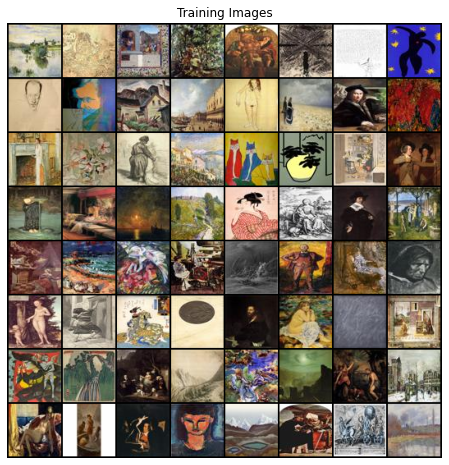

In [3]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
@dataclass
class Hyperparameter:
    num_classes: int        = 27
    batchsize: int          = 128
    num_epochs: int         = 10
    latent_size: int        = 150
    n_critic: int           = 1
    critic_size: int        = 1024
    generator_size: int     = 1024
    critic_hidden_size: int = 1024
    gp_lambda: float        = 0.1
        
hp = Hyperparameter()

lr = 0.0005

In [5]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.latent_embedding = nn.Sequential(
            nn.Linear(hp.latent_size, hp.generator_size // 2),
        )
        self.condition_embedding = nn.Sequential(
            nn.Linear(hp.num_classes, hp.generator_size // 2),
        )
        self.tcnn = nn.Sequential(
        nn.ConvTranspose2d( hp.generator_size, hp.generator_size, 4, 1, 0),
        nn.BatchNorm2d(hp.generator_size),
        nn.ReLU(inplace=True),
        nn.ConvTranspose2d( hp.generator_size, hp.generator_size // 2, 4, 2, 1),
        nn.BatchNorm2d(hp.generator_size // 2),
        nn.ReLU(inplace=True),
        nn.ConvTranspose2d( hp.generator_size // 2, hp.generator_size // 4, 4, 2, 1),
        nn.BatchNorm2d(hp.generator_size // 4),
        nn.ReLU(inplace=True),
        nn.ConvTranspose2d( hp.generator_size // 4, hp.generator_size // 8, 4, 2, 1),
        nn.BatchNorm2d(hp.generator_size // 8),
        nn.ReLU(inplace=True),
        nn.ConvTranspose2d( hp.generator_size // 8, 3, 4, 2, 1),
        nn.Tanh()
        )
        
    def forward(self, latent, condition):
        vec_latent = self.latent_embedding(latent)
        vec_class = self.condition_embedding(condition)
        combined = torch.cat([vec_latent, vec_class], dim=1).reshape(-1, hp.generator_size, 1, 1)
        return self.tcnn(combined)

class Critic(nn.Module):
    def __init__(self):
        super(Critic, self).__init__()
        self.condition_embedding = nn.Sequential(
            nn.Linear(hp.num_classes, hp.critic_size * 4),
        )
        self.cnn_net = nn.Sequential(
        nn.Conv2d(3, hp.critic_size // 16, 4, 2, 1),
        nn.InstanceNorm2d(hp.critic_size // 16, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(hp.critic_size // 16, hp.critic_size // 8, 4, 2, 1),
        nn.InstanceNorm2d(hp.critic_size // 8, affine=True),
        nn.LeakyReLU(0.2, inplace=True),   
        nn.Conv2d(hp.critic_size // 8, hp.critic_size // 4, 4, 2, 1),
        nn.InstanceNorm2d(hp.critic_size // 4, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(hp.critic_size // 4, hp.critic_size // 2, 4, 2, 1),
        nn.InstanceNorm2d(hp.critic_size // 2, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(hp.critic_size // 2, hp.critic_size, 4, 2, 1),
        nn.InstanceNorm2d(hp.critic_size, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Flatten(),
        )
        self.Critic_net = nn.Sequential(
        nn.Linear(hp.critic_size * 8, hp.critic_hidden_size),
        nn.LeakyReLU(0.2, inplace=True),   
        nn.Linear(hp.critic_hidden_size, 1),
        )
        
    def forward(self, image, condition):
        vec_condition = self.condition_embedding(condition)
        cnn_features = self.cnn_net(image)
        combined = torch.cat([cnn_features, vec_condition], dim=1)
        #print(cnn_features.shape, vec_condition.shape, combined.shape)
        return self.Critic_net(combined)

In [6]:
#transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])
                                
#dataset  = torchvision.datasets.MNIST("mnist", download=True, transform=transform)
#dataloader = torch.utils.data.DataLoader(dataset, batch_size=hp.batchsize, num_workers=1,
#                                         shuffle=True, drop_last=True, pin_memory=True)

critic, generator = Critic().to("cuda"), Generator().to("cuda")

critic_optimizer = optim.AdamW(critic.parameters(), lr=lr,betas=(0., 0.9))
generator_optimizer = optim.AdamW(generator.parameters(), lr=lr,betas=(0., 0.9))

In [7]:
img_list, generator_losses, critic_losses = [], [], []
iters = 0
all_labels = torch.eye(hp.num_classes, dtype=torch.float32, device="cuda")
fixed_noise = torch.randn((216, hp.latent_size), device="cuda")
fixed_class_labels = all_labels[[i for i in list(range(hp.num_classes)) for idx in range(8)]]

start_time = time.time()
for epoch in range(hp.num_epochs):
    for batch_idx, data in enumerate(dataloader, 0):
        real_images, real_class_labels = data[0].to("cuda"), all_labels[data[1]].to("cuda")
        
        grad_tensor = torch.ones((real_images.shape[0], 1), device="cuda")
        
        # Update critic
        critic_optimizer.zero_grad()
        
        critic_output_real = critic(real_images, real_class_labels)
        critic_loss_real = critic_output_real.mean()

        noise = torch.randn((real_images.shape[0], hp.latent_size), device="cuda")
        with torch.no_grad(): fake_image = generator(noise, real_class_labels)
        critic_output_fake = critic(fake_image, real_class_labels)
        critic_loss_fake = critic_output_fake.mean()

        alpha = torch.rand((real_images.shape[0], 1), device="cuda")
        interpolates = (alpha.view(-1, 1, 1, 1) * real_images + ((1. - alpha.view(-1, 1, 1, 1)) * fake_image)).requires_grad_(True)
        d_interpolates = critic(interpolates, real_class_labels)
        gradients = autograd.grad(d_interpolates, interpolates, grad_tensor, create_graph=True, only_inputs=True)[0]
        gradient_penalty = hp.gp_lambda * ((gradients.view(hp.batchsize, -1).norm(dim=1) - 1.) ** 2).mean()

        critic_loss = -critic_loss_real + critic_loss_fake  + gradient_penalty
        
        critic_loss.backward()
        critic_optimizer.step()

        if batch_idx % hp.n_critic == 0:
            # Update Generator
            generator_optimizer.zero_grad()
            
            fake_class_labels = all_labels[torch.randint(hp.num_classes, size=[hp.batchsize])]
            noise = torch.randn((hp.batchsize, hp.latent_size), device="cuda")
            fake_image = generator(noise, fake_class_labels)
            critic_output_fake = critic(fake_image, fake_class_labels)
            generator_loss = -critic_output_fake.mean()
            
            generator_loss.backward()
            generator_optimizer.step()
        
        # Output training stats
        if batch_idx % 100 == 0:
            elapsed_time = time.time() - start_time
            print(f"[{epoch:>2}/{hp.num_epochs}][{iters:>7}][{elapsed_time:8.2f}s]\t"
                  f"d_loss/g_loss: {critic_loss.item():4.2}/{generator_loss.item():4.2}\t")
       
        # Save Losses for plotting later
        generator_losses.append(generator_loss.item())
        critic_losses.append(critic_loss.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 200 == 0) or ((epoch == hp.num_epochs - 1) and (batch_idx == len(dataloader) - 1)):
            with torch.no_grad(): fake_images = generator(fixed_noise, fixed_class_labels).cpu()
            img_list.append(vutils.make_grid(fake_images, padding=2, normalize=True))
            
        iters += 1

[ 0/10][      0][    3.94s]	d_loss/g_loss: 0.023/ 3.2	
[ 0/10][    100][   59.49s]	d_loss/g_loss: -1e+01/-1.2e+02	
[ 0/10][    200][  115.94s]	d_loss/g_loss: -1.6e+01/-1.2e+02	
[ 0/10][    300][  174.78s]	d_loss/g_loss: -1.9e+01/-9.4e+01	
[ 0/10][    400][  234.10s]	d_loss/g_loss: -2.3e+01/-9e+01	
[ 0/10][    500][  293.68s]	d_loss/g_loss: -1.2e+01/-1e+02	
[ 0/10][    600][  353.32s]	d_loss/g_loss: -8.9/-7.9e+01	
[ 1/10][    637][  377.17s]	d_loss/g_loss: 9.6e+01/-1.5e+02	
[ 1/10][    737][  437.01s]	d_loss/g_loss: -8.4/-1.1e+02	
[ 1/10][    837][  497.06s]	d_loss/g_loss: -1.6e+01/-5.4e+01	
[ 1/10][    937][  556.64s]	d_loss/g_loss: -1.7/-1.9e+02	
[ 1/10][   1037][  616.79s]	d_loss/g_loss: -8.2e+01/-4.6e+02	
[ 1/10][   1137][  677.57s]	d_loss/g_loss: 1.2e+02/-1e+03	
[ 1/10][   1237][  737.63s]	d_loss/g_loss: -1.1e+01/-1.9e+03	
[ 2/10][   1274][  761.05s]	d_loss/g_loss: -3.3e+02/-2e+03	
[ 2/10][   1374][  820.37s]	d_loss/g_loss: -1.7e+02/-2.2e+03	
[ 2/10][   1474][  880.15s]	d_loss/g_lo

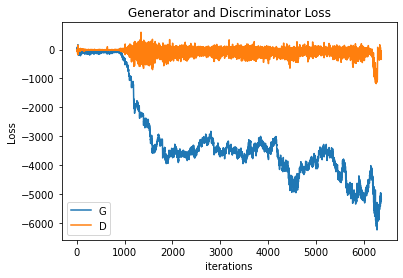

In [33]:
plt.title("Generator and Discriminator Loss")
plt.plot(generator_losses,label="G")
plt.plot(critic_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [9]:
len(img_list)

33

In [34]:
img_list[15].shape

torch.Size([3, 1784, 530])

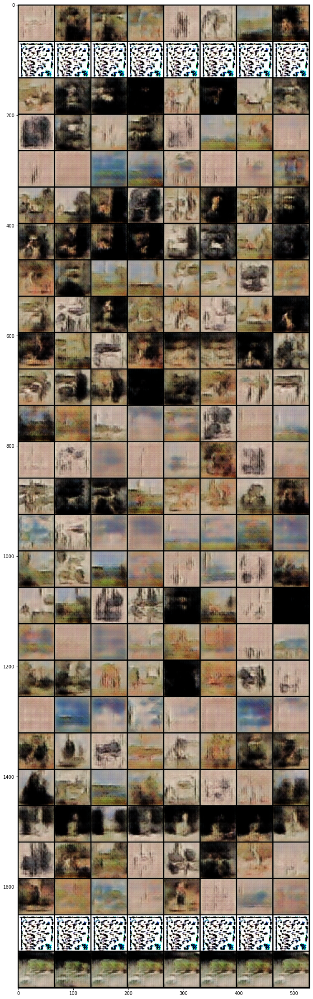

In [49]:
from matplotlib.pyplot import figure
figure(figsize=(100,40))

plt.imshow(np.transpose(img_list[13], [1, 2, 0]))

Animation size has reached 21479133 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


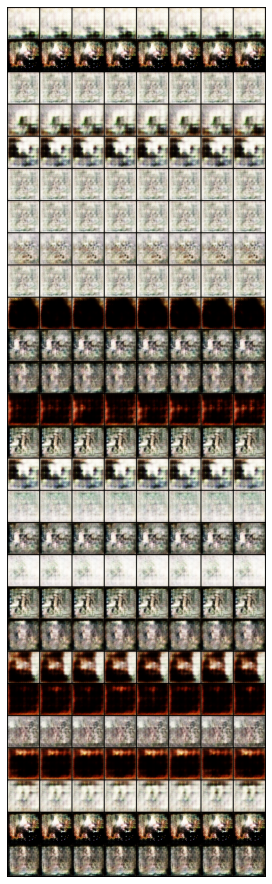

In [12]:
import matplotlib.animation as animation
from IPython.display import HTML
#%%capture
fig = plt.figure(figsize=(20,16))
plt.axis("off")
ims = [[plt.imshow(i.permute(1,2,0), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())